<a href="https://colab.research.google.com/github/jumbokh/nknu-class/blob/main/notebooks/CNN_1_real_diff_from_chap4_visualizing_what_convnets_learn_2_pattern.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 這個程式在觀看什麼樣的輸入是可以讓我們已經學會的辨識事物的網路被激發。
## 就像是課程第六章中，我們說人的大腦皮脂層有六層運作，如果被訓練完成後，整組網路是為了辨識愛因斯坦，則我們
* 放一個 iphone: 理論上，沒有任何神經元被激發
* 放一首歌：沒有任何神經元被激發
* 放 E = $MC^2$: 可能有一些神經元被激發
* 放 一個伸舌頭的淘氣畫面：可能有一些神經元被激發
* 放愛因斯坦的照片：應該會幾乎都被激發！

所以這真的是在偵測愛因斯坦的神經網路區。

我們的網路是被訓練好的，所以沒有辦法用 gradient descent 學習... 
所以我們用... 

## 設計看看：
我們要觀察一個設計好的網路函式，看看某一層 （比如 'block3_conv1'）中某一個 filter 是在偵測什麼。
所以網路是訓練好的，
我們的 target 就是 'block3_conv1' 的第一個 filter 被點亮。
比對：
* Gradient Descent: loss: crossentrop of Y and Y_hat

* filter_pattern:  mean(block3_conv1[0])

* Gradient Descent: weights 

* filter_pattern:  input_img_pixel

* w1 <== w0 - lr* gradient(loss), g(loss) = d(L(Y, Y_hat)/d(w)

* pixel1 <== pixel0 + lr*gradient(mean(block3_conv1[0]), g(mean)b3c1[0]) = d(mb3c10)/dpixel


```
loss = K.mean(layer_output[:, :, :, filter_index]) 

grads = K.gradents[loss, input]

design a function K.functions(input, grads) # no loss necessary, 
# since input an image, it generates a loss(layer_output) (through model?), then calculate grads by (loss, input)

```






In [ ]:
#%tensorflow_version 1.x
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
import keras
#keras.__version__
import os
from keras.models import load_model

In [ ]:
from keras.applications.vgg16 import VGG16
from keras import backend as K
import matplotlib.pyplot as plt


model = VGG16(weights='imagenet',
              include_top=False)

layer_name = 'block3_conv1'
filter_index = 0

layer_output = model.get_layer(layer_name).output
loss = K.mean(layer_output[:, :, :, filter_index]) #(none, feature_map_h, feature_map_w, feature_map_index/filter_index)
model.summary()

58900480/58889256 [==============================] - 0s 0us/step
Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
______________________________________________________________

# 學習點 1

In [ ]:
# The call to `gradients` returns a list of tensors (of size 1 in this case)
# hence we only keep the first element -- which is a tensor.
#if we ask: grads = K.gradients(loss, model.input), it will return a list with one element in this list.  And this only element is an [None, None, None, 3] tensor
# 其實就是 loss 對每一個 pixel 作偏微分
# gradient descent w = w - eta gradient (dL/dw)
# gradient ascent p = p + step gradient (dL/dp)

grads = K.gradients(loss, model.input)[0] # grads.shape: TensorShape([None, None, None, 3])


In [ ]:
# We add 1e-5 before dividing so as to avoid accidentally dividing by 0. 
# rms(e)
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

In [ ]:
iterate = K.function([model.input], [loss, grads]) # input: model.input, then generate loss, and grads

# Let's test it:
import numpy as np
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

In [ ]:
type(loss_value) #numpy.float32
loss_value.shape #()
loss_value # 0.0
grads_value.shape #(1,150,150,3)

(1, 150, 150, 3)

1. 我們設定 loss 是某一個 festure map 的平均值。

1. 我們設定 grads 是 d(loss)/d(input): 所以要求甚麼樣的 input 讓 loss 最大

1. function: 就是 input image ==> loss, and grads
確實 input image 每一層都會有輸出，就可以產出 loss，有了 loss and input 就可以有 grads.

根據 2. and 效法梯度下降，我們有 input = input + lr*grads


In [ ]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [ ]:
def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = K.function([model.input], [loss, grads])
    
    # We start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        # input_img_data = input_img_data + grads_value * step

        # w = w - eta * grads <== grads desecnt
        # p = p + eta(step)*grads(loss, input_p) <== grads asscent
        
    img = input_img_data[0]
    return deprocess_image(img)

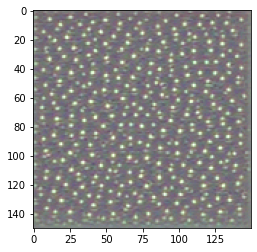

In [ ]:
plt.imshow(generate_pattern('block3_conv1', 0))
plt.show()

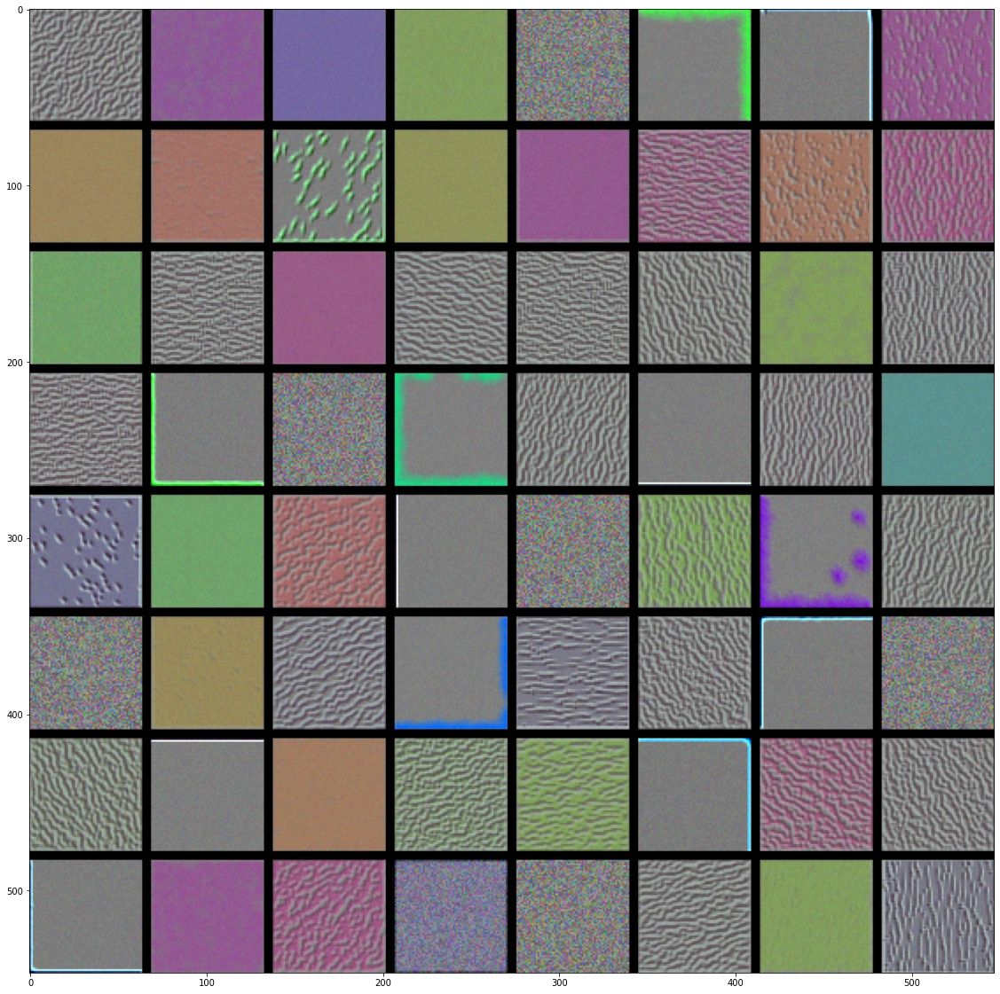

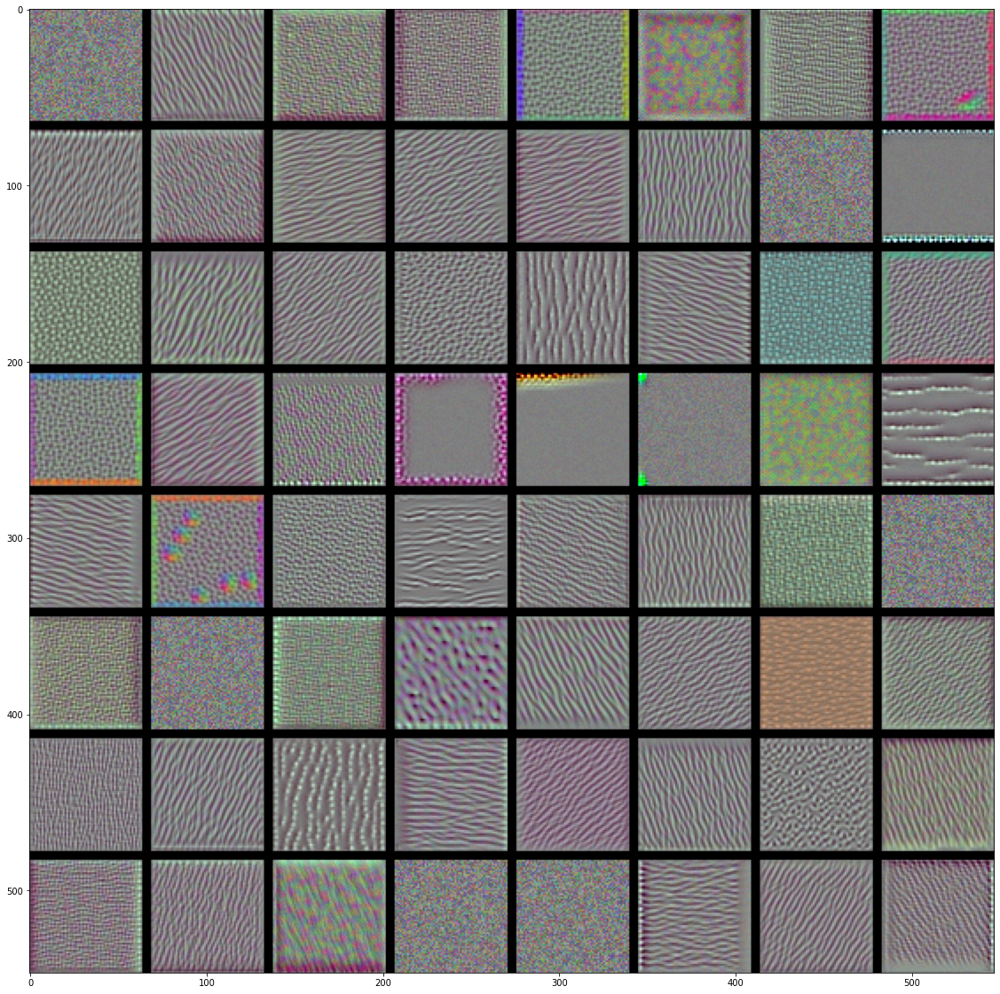

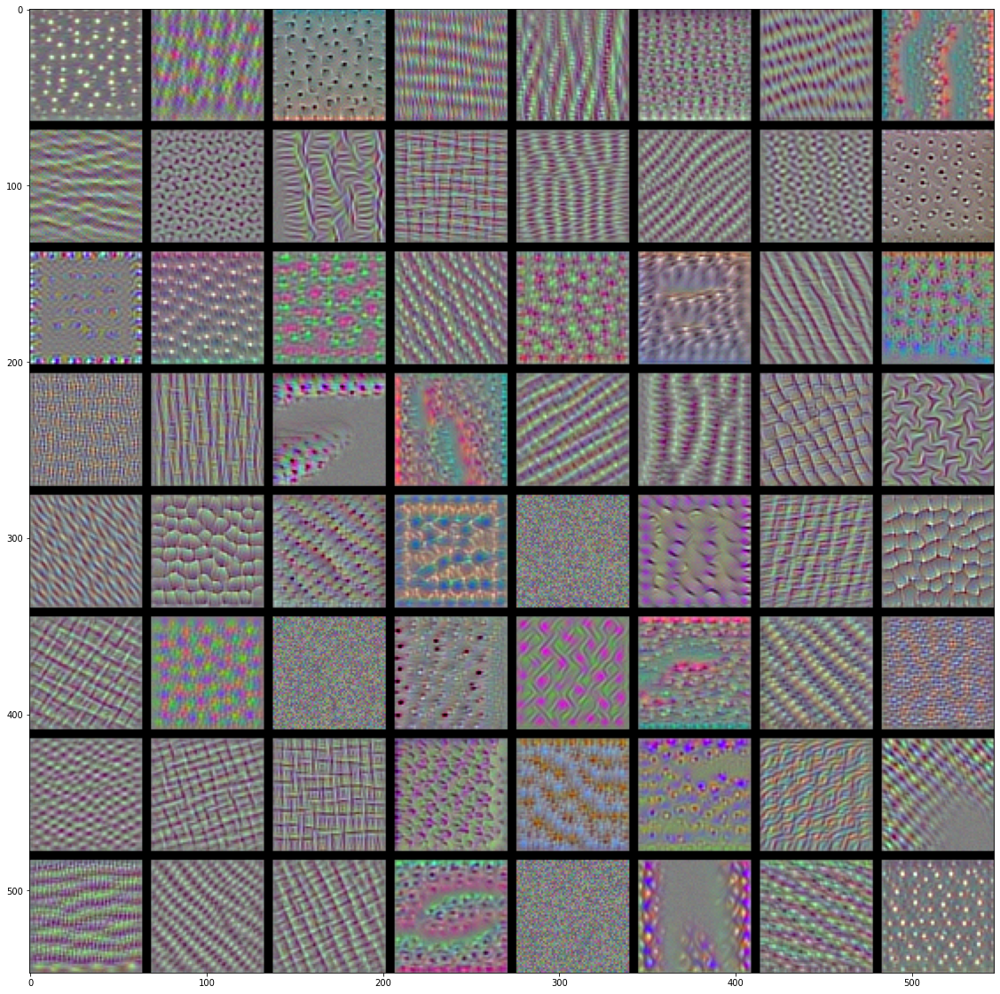

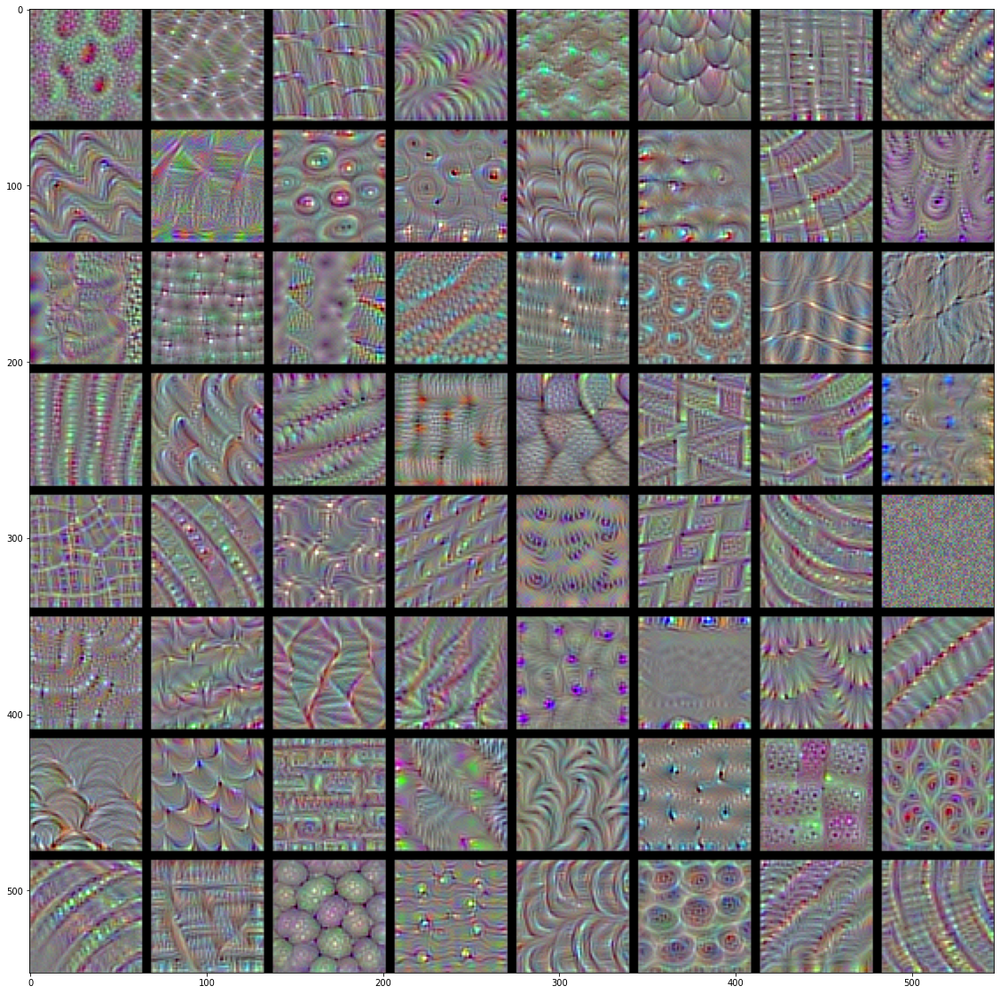

In [ ]:
for layer_name in ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow(results/255)
    plt.show()

In [ ]:
import keras
keras.__version__

'2.6.0'

# 第一個程式純粹觀察
## 這一個程式是改變網路的輸入，去找出誰可以讓我們的 features map 點亮，也就是誰是我們的 filters 的目標: 用到了 Gradient Ascent 

## Visualizing convnet filters


Another easy thing to do to inspect the filters learned by convnets is to display the visual pattern that each filter is meant to respond 
to. This can be done with __gradient ascent in input space__: applying __gradient descent__ to the value of the input image of a convnet so 
as to maximize the response of a specific filter, starting from a blank input image. The resulting input image would be one that the chosen 
filter is maximally responsive to.

The process is simple: we will build a loss function that maximizes the value of a given filter in a given convolution layer, then we 
will use stochastic gradient descent to adjust the values of the input image so as to maximize this activation value. For instance, here's 
a loss for the activation of filter 0 in the layer "block3_conv1" of the VGG16 network, pre-trained on ImageNet:

In [ ]:
from keras.applications.vgg16 import VGG16
from keras import backend as K
import matplotlib.pyplot as plt


model = VGG16(weights='imagenet',
              include_top=False)

layer_name = 'block3_conv1'
filter_index = 0

layer_output = model.get_layer(layer_name).output
loss = K.mean(layer_output[:, :, :, filter_index]) 
# 思考這個是甚麼!!
# 通常 output 是 好幾張 feature maps, [none, none, none, filter_index]
# 雖然名為 loss, 其實我們是要上這個值愈大愈好啊！
# 後續的 grads = K.gradients(loss, model.input)[0] 就是在說，什麼樣的輸入, 可以讓我們的 "loss" 變化
# 如果用 gradient descent 當然就是讓 loss 最小
# 如果用 gradient ascent 當然就是讓 loss 最大
# input_img_data += grads_value * step

# 思考上一個 k.mean(layer_output[:, :, :, filter_index])  

In [ ]:
model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

To implement gradient descent, we will need the gradient of this loss with respect to the model's input. To do this, we will use the 
`gradients` function packaged with the `backend` module of Keras:

In [ ]:
# The call to `gradients` returns a list of tensors (of size 1 in this case)
# hence we only keep the first element -- which is a tensor.
grads = K.gradients(loss, model.input)[0]

A non-obvious trick to use for the gradient descent process to go smoothly is to normalize the gradient tensor, by dividing it by its L2 
norm (the square root of the average of the square of the values in the tensor). This ensures that the magnitude of the updates done to the 
input image is always within a same range.

In [ ]:
# We add 1e-5 before dividing so as to avoid accidentally dividing by 0.
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

Now we need a way to compute the value of the loss tensor and the gradient tensor, given an input image. We can define a Keras backend 
function to do this: `iterate` is a function that takes a Numpy tensor (as a list of tensors of size 1) and returns a list of two Numpy 
tensors: the loss value and the gradient value.

In [ ]:
iterate = K.function([model.input], [loss, grads])

# Let's test it:
import numpy as np
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

At this point we can define a Python loop to do stochastic gradient descent:

In [ ]:
# We start from a gray image with some noise
input_img_data = np.random.random((1, 150, 150, 3)) * 20 + 128.


# Run gradient ascent for 40 steps
step = 1.  # this is the magnitude of each gradient update
for i in range(40):
    # Compute the loss value and gradient value
    loss_value, grads_value = iterate([input_img_data])
    # Here we adjust the input image in the direction that maximizes the loss
    input_img_data += grads_value * step

The resulting image tensor will be a floating point tensor of shape `(1, 150, 150, 3)`, with values that may not be integer within `[0, 
255]`. Hence we would need to post-process this tensor to turn it into a displayable image. We do it with the following straightforward 
utility function:

In [ ]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

Now we have all the pieces, let's put them together into a Python function that takes as input a layer name and a filter index, and that 
returns a valid image tensor representing the pattern that maximizes the activation the specified filter:

In [ ]:
def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = K.function([model.input], [loss, grads])
    
    # We start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

Let's try this:

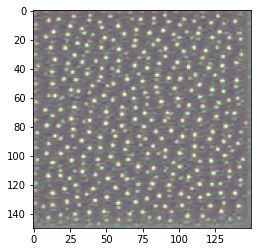

In [ ]:
plt.imshow(generate_pattern('block3_conv1', 0))
plt.show()

It seems that filter 0 in layer `block3_conv1` is responsive to a polka dot pattern.

Now the fun part: we can start visualising every single filter in every layer. For simplicity, we will only look at the first 64 filters in 
each layer, and will only look at the first layer of each convolution block (block1_conv1, block2_conv1, block3_conv1, block4_conv1, 
block5_conv1). We will arrange the outputs on a 8x8 grid of 64x64 filter patterns, with some black margins between each filter pattern.

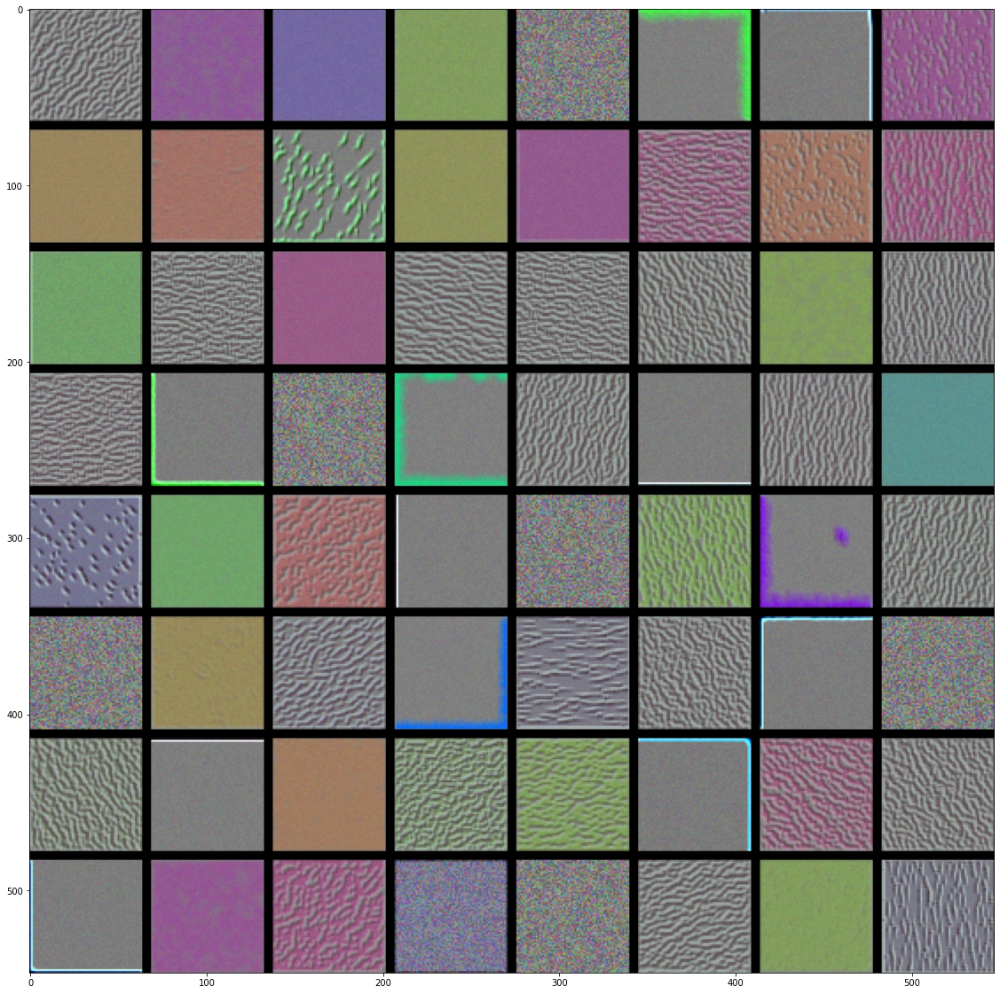

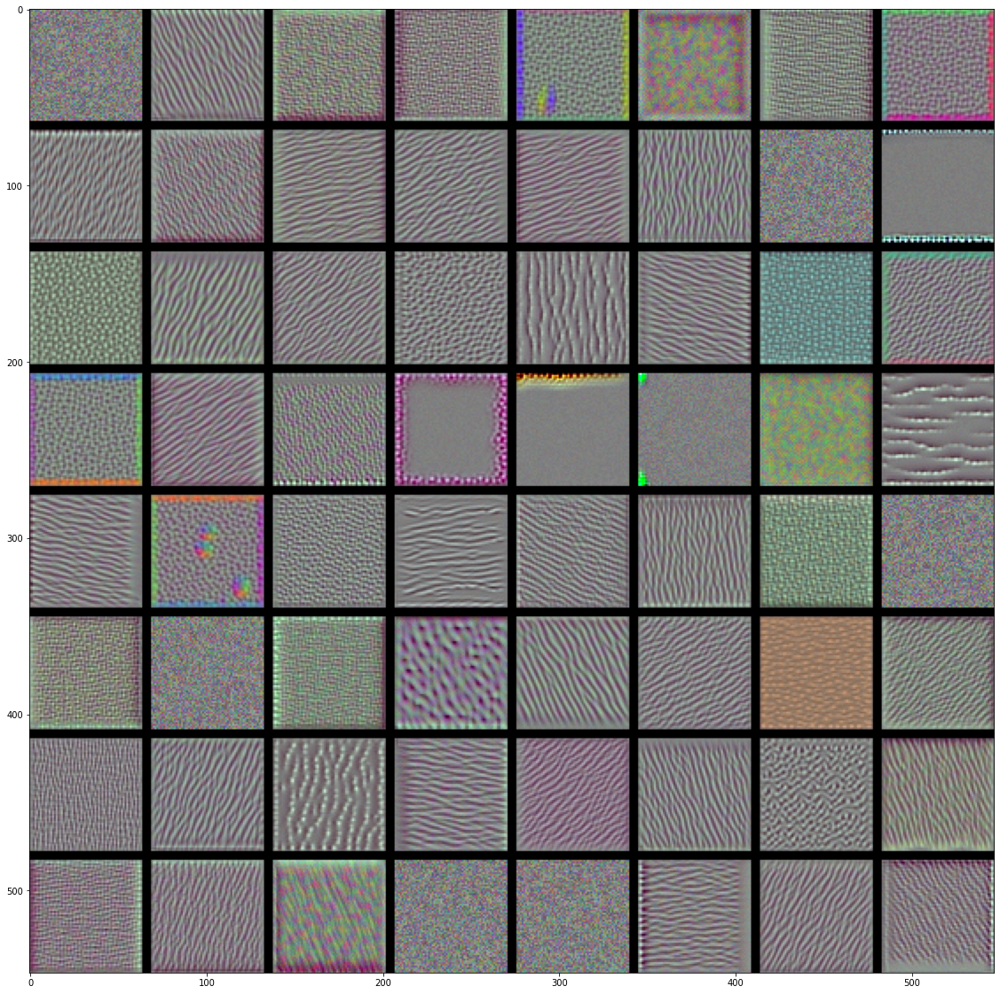

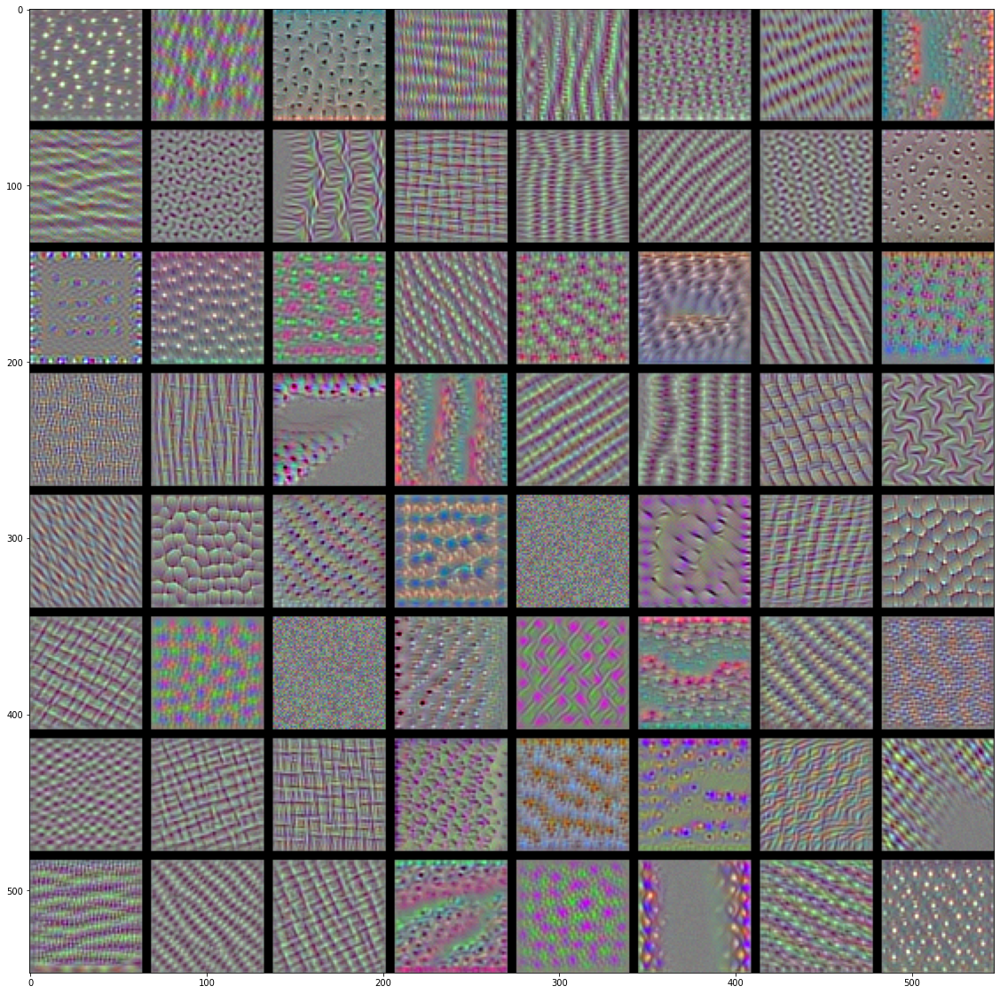

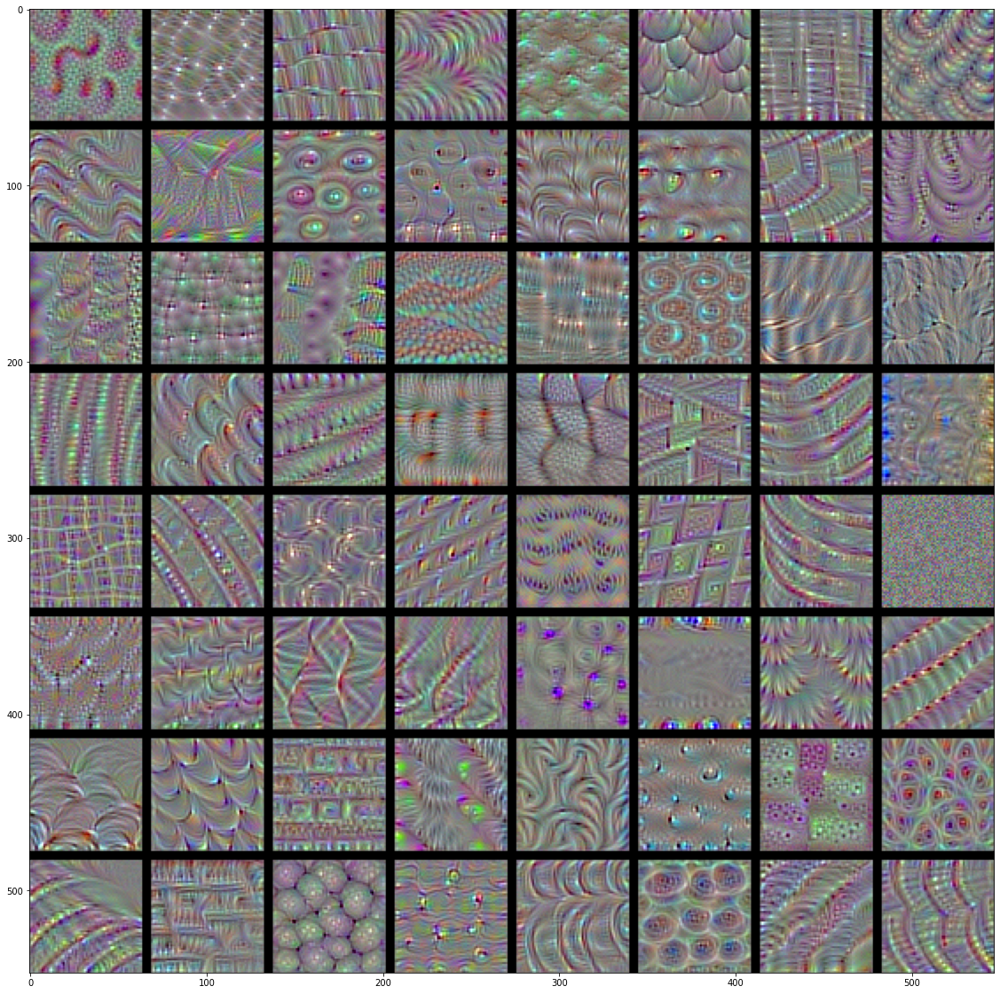

In [ ]:
for layer_name in ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow(results/255)
    plt.show()

These filter visualizations tell us a lot about how convnet layers see the world: each layer in a convnet simply learns a collection of 
filters such that their inputs can be expressed as a combination of the filters. This is similar to how the Fourier transform decomposes 
signals onto a bank of cosine functions. The filters in these convnet filter banks get increasingly complex and refined as we go higher-up 
in the model:

* The filters from the first layer in the model (`block1_conv1`) encode simple directional edges and colors (or colored edges in some 
cases).
* The filters from `block2_conv1` encode simple textures made from combinations of edges and colors.
* The filters in higher-up layers start resembling textures found in natural images: feathers, eyes, leaves, etc.

In [ ]:
cat = plt.imread('cat150.jpg')
plt.imshow(cat)
cat.shape

FileNotFoundError: ignored

In [ ]:

input_img_data = tf.keras.preprocessing.image.load_img('cat150.jpg')
input_img_data = tf.keras.preprocessing.image.img_to_array(input_img_data)
input_img_data = np.expand_dims(input_img_data, axis=0)
input_img_data.shape

In [ ]:
from PIL import Image
import tensorflow as tf


def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = K.function([model.input], [loss, grads])
    
    # We start from a gray image with some noise
    #input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.


    input_img_data = tf.keras.preprocessing.image.load_img('cat150.jpg')
    input_img_data = tf.keras.preprocessing.image.img_to_array(input_img_data)
    input_img_data = np.expand_dims(input_img_data, axis=0)
    


    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

In [ ]:
#for layer_name in ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']:
for layer_name in ['block4_conv1']:

    size = 150
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow(results/255)
    plt.show()